 # Modelado de temas para los años 2019 comparado con 2020 de Noticias en twitter
 
## Adquisición de datos
 
 ### Cuentas de twitter tenidas en cuenta
* Noticias Caracol - @NoticiasCaracol
* Noticias RCN - @NoticiasRCN
* Noticentro1 CM& - @CMILANOTICIA
* CityTV - @Citytv
* El tiempo - @ELTIEMPO
* El espectador - @elespectador
* Publimetro @PublimetroCol
* El Nuevo Siglo - @ElNuevoSiglo
* Diario ADN - @adncolombia
* La Nación - @PrensaLaNacion
* El colombiano - @elcolombiano
* Periódico El Mundo - @elmundomedellin
* El Heraldo - @elheraldoco
* Portafolio - @Portafolioco

`Fabián Castro`

In [238]:
import pandas as pd
import numpy as np
import re
import regex
import emoji
import random

import tweepy
import json

import snscrape.modules.twitter as sntwitter

from IPython.core.display import display, HTML

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import MiniBatchKMeans
from sklearn.pipeline import make_pipeline
from sklearn.decomposition import TruncatedSVD
from sklearn.metrics import silhouette_score
from collections import Counter


import matplotlib.pyplot as plt
import plotly.io as pio
import plotly.express as px
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from wordcloud import WordCloud
%matplotlib inline

import pyLDAvis.gensim_models
from gensim.models import LdaModel
from gensim.corpora import Dictionary
from pprint import pprint

import warnings; warnings.simplefilter('ignore')
from nltk.corpus import stopwords
stopwords_es = stopwords.words('spanish')
stopwords_es.extend(['gt'])

In [8]:
with open('../Access/client_secret.json') as file:
    CREDS = json.load(file)
    
# Auth v1
auth = tweepy.OAuthHandler(CREDS['api_key'], CREDS['api_secret_key'])
api = tweepy.API(auth, wait_on_rate_limit=True)

In [9]:
news_user_names = ['NoticiasCaracol', 'NoticiasRCN', 'CMILANOTICIA',
                   'Citytv', 'ELTIEMPO', 'elespectador', 'PublimetroCol',
                   'ElNuevoSiglo', 'adncolombia', 'PrensaLaNacion',
                   'elcolombiano', 'elmundomedellin', 'elheraldoco', 'Portafolioco']

In [241]:
def get_user_data(api, screen_name):
    """
    Gets specific twitter user data:
    * Name
    * Description
    * Banner Image
    * Tweet count
    
    parameters:
    __________
    
    api: twitter API wrapper
    screen_name: identifier of the twitter account (the one that is folowed by "@")
    
    Returns:
    Dictionary holding the above information
    """

    params = dict(screen_name = screen_name)
    response = api.get_user(**params)._json
    Keys = ['name', 'description', 'profile_banner_url', 'statuses_count']
    return {key: response[key] for key in Keys}

def print_user_data(info):
    """
    Display information for a twitter user
    
    Parameters:
    __________
    
    info: dictionary containing the following information about a twitter user: name,
        description and background image
    """
    
    html = f"""
    <img src="{info['profile_banner_url']}" width = "800" height = "600">
    <p style = "font-size: 50px">{info['name']}</p>
    <p>{info['description']}</p>
    <p> No tweets: {info['statuses_count']}</p>
    """
    display(HTML(html))
    
def pre_process(text):
    text = text.lower()
    text = re.sub(r'[\W\d_]+',' ', text)
    text = [word for word in text.split() if word not in stopwords_es]
    return " ".join(text)

pattern1 = '?P<pic>pic.twitter.com/[^\s]+'
pattern2 = '?P<url>https?://[^\s]+'

def text_clean(row):
    text = row['content']
    
    links = [tuple(j for j in i if j)[-1] for i in re.findall(f"({pattern1})|({pattern2})",text)]
    for link in links:
        text = text.replace(link,"")
             
    hashtags = [interaction for interaction in text.split() if interaction.startswith("#")]
    for hashtag in hashtags:
        text = text.replace(hashtag,"")
        
    mentions = [interaction for interaction in text.split() if interaction.startswith("@")]
    for mention in mentions:
        text = text.replace(mention,"")
        
    emoji_list = []
    data = regex.findall(r'\X', text)
    for word in data:
        if any(char in emoji.UNICODE_EMOJI['en'] for char in word):
            emoji_list.append(word)
            text = text.replace(word,"")
        
    pp = pre_process(text)
    return text, pp, emoji_list

def makeTfidf(pre_processed):
    tfidf_vect = TfidfVectorizer(ngram_range = (1, 2))
    return tfidf_vect.fit_transform(pre_processed)

def runKMeans(tfidf, k):
    kinert = {}
    for n_clusters in range(2, k + 1):
        clusterer = MiniBatchKMeans(n_clusters = n_clusters, random_state = 42, max_iter=5000)
        model = clusterer.fit(tfidf)
        
        ## inertia
        kinert[n_clusters] = model.inertia_

        ##silhouette
        cluster_labels = model.predict(tfidf)
        silhouette_avg = silhouette_score(tfidf, cluster_labels)
        print("For n_clusters =", n_clusters,
            "The average silhouette_score is :", silhouette_avg)
        
    plt.plot(list(kinert.keys()), list(kinert.values()), 'bx-')
    plt.title('Elbow method')
    plt.xlabel('K clusters')
    plt.ylabel('Inertia')
    plt.xticks(range(2, k + 1));
    
def plotEmojis(df_column):
    temp_emojis = pd.DataFrame(list(zip(Counter(sum(df_column.values,[])).keys(),Counter(sum(df_column.values,[])).values())))
    temp_emojis.columns = ['emoji', 'cnt']
    temp_emojis.sort_values('cnt', ascending=False, inplace=True)

    trace = go.Bar(x=temp_emojis.emoji.values[:20],
                   y=temp_emojis.cnt.values[:20])

    layout = go.Layout(title='Emojis más usados', width = 1000, height = 600)

    fig = go.Figure(data=[trace], layout=layout)
    iplot(fig)
    
def color_func(word, font_size, position, orientation, random_state=None,
                    **kwargs):
    y = (252,209,22)
    b = (0,56,147)
    r = (206,17,38)
    return "rgb(%d, %d, %d)" % random.choice([y, b, r])

def makeWordCloud(df_column):
    words = df_column.str.cat(sep = ' ')
    
    wordcloud = WordCloud(width = 800,
                      height = 800,
                      max_font_size = 150,
                      max_words = 100,
                      background_color = 'white'
                     ).generate(words)
    plt.figure(figsize = (10,10))
    plt.imshow(wordcloud.recolor(color_func = color_func, random_state = 42), interpolation = 'bilinear')
    plt.axis('off')
    plt.show()

In [16]:
for twitter_user in news_user_names:
    print_user_data(get_user_data(api, twitter_user))
    print("*"*50)

**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


In [20]:
%%time
tweets = []
for tweet_user in news_user_names:
    print(f'{tweet_user} started processing...')
    cnt = 0
    for i, tweet in enumerate(sntwitter.TwitterSearchScraper(f'(from:{tweet_user})' + f'since:2019-01-01 until:2020-12-31 -filter:replies').get_items()) :
        temp = []
        temp.append(tweet_user)
        temp.append(tweet.date)
        temp.append(tweet.content)

        tweets.append(temp)
        cnt += 1
    print(f'{tweet_user} user process finalized. {cnt} tweets loaded.')

NoticiasCaracol started processing...
NoticiasCaracol user process finalized. 106008 tweets loaded.
NoticiasRCN started processing...
NoticiasRCN user process finalized. 99610 tweets loaded.
CMILANOTICIA started processing...
CMILANOTICIA user process finalized. 37156 tweets loaded.
Citytv started processing...
Citytv user process finalized. 60864 tweets loaded.
ELTIEMPO started processing...
ELTIEMPO user process finalized. 91948 tweets loaded.
elespectador started processing...
elespectador user process finalized. 170669 tweets loaded.
PublimetroCol started processing...
PublimetroCol user process finalized. 53101 tweets loaded.
ElNuevoSiglo started processing...
ElNuevoSiglo user process finalized. 23330 tweets loaded.
adncolombia started processing...
adncolombia user process finalized. 4172 tweets loaded.
PrensaLaNacion started processing...
PrensaLaNacion user process finalized. 13508 tweets loaded.
elcolombiano started processing...
elcolombiano user process finalized. 34193 twe

In [21]:
tweets = pd.DataFrame(tweets)
tweets.columns = ['user','date', 'content']
tweets.to_csv('../datasets/tweets_news.csv', index = False)

In [143]:
tweets = pd.read_csv('../datasets/tweets_news.csv', engine = 'c', header = 0, parse_dates = ['date'])

In [144]:
tweets[['text_clean', 'pp', 'emojis']] = tweets.apply(text_clean, axis=1, result_type='expand')

In [133]:
tweets.sample(6)

,user,date,content,text_clean,pp,emojis
256698,Citytv,2020-07-08 23:10:58+00:00,"INTERNACIONAL | A medida que pasa el tiempo, c...","INTERNACIONAL | A medida que pasa el tiempo, c...",internacional medida pasa tiempo cada vez líde...,[➡️]
797040,Portafolioco,2019-07-06 20:27:40+00:00,Senadores denuncian nuevas 'chuzadas' https://...,Senadores denuncian nuevas 'chuzadas',senadores denuncian nuevas chuzadas,[]
107858,NoticiasRCN,2020-12-13 01:32:28+00:00,Con la unión de más de 500 establecimientos co...,Con la unión de más de 500 establecimientos co...,unión establecimientos comerciales bogotá perm...,[]
194871,NoticiasRCN,2019-03-03 18:20:00+00:00,La pesadilla de DMG continúa afectando a vícti...,La pesadilla de DMG continúa afectando a vícti...,pesadilla dmg continúa afectando víctimas pirá...,[]
461910,elespectador,2020-03-27 13:45:10+00:00,El SARS-Cov-2 es un coronavirus zoonótico que ...,El SARS-Cov-2 es un coronavirus zoonótico que ...,sars cov coronavirus zoonótico transmitió inic...,[]
325456,ELTIEMPO,2020-07-12 14:00:01+00:00,"¡Buenos días! Feliz domingo ☀️, terminemos el ...","¡Buenos días! Feliz domingo , terminemos el fi...",buenos días feliz domingo terminemos fin seman...,"[☀️, 🏃🏽, ⬇️]"


In [21]:
tweets['date'].dt.year.value_counts()

2019    407847
2020    397654
Name: date, dtype: int64

## Gráficas

In [6]:
temp = tweets['date'].groupby([tweets['date'].dt.year.rename('year'),
                               tweets['date'].dt.month.rename('month')]).agg({'count'}).reset_index()
month_names = {1:'Ene', 2:'Feb', 3:'Mar', 4:'Abr', 5:'May', 6:'Jun',
               7:'Jul', 8:'Ago', 9:'Sep', 10:'Oct',11:'Nov',12:'Dic'}

In [7]:
mean_2019_tweets = temp[temp['year'] == 2019]['count'].mean()
mean_2020_tweets = temp[temp['year'] == 2020]['count'].mean()

In [8]:
fig = px.bar(temp,
             x = 'month',
             y = 'count',
             text = 'count',
             facet_col = 'year',
             labels = {'month':'Mes', 'count':'CNT', 'year':'Año'},
             width = 1000,
             height = 600)
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_xaxes(type='category',
                 tickvals = list(month_names.keys()),
                 ticktext = list(month_names.values()))

fig.add_hline(y = mean_2019_tweets, line_dash = 'dot', col = 1)
fig.add_hline(y = mean_2020_tweets, line_dash = 'dot', col = 2)

In [26]:
temp = tweets['date'].groupby([tweets['date'].dt.year.rename('year'),
                               tweets['date'].dt.month.rename('month'), tweets['user']]).agg({'count'}).reset_index()

In [29]:
fig = px.line(temp,
              x = 'month',
              y = 'count',
              facet_col = 'year',
              color = 'user',
              labels = {'month':'Mes', 'count':'CNT'},
              width = 1000,
              height = 600)
fig.update_xaxes(type = 'category',
                 tickvals = list(month_names.keys()),
                 ticktext = list(month_names.values()))
fig.update_traces(mode="markers+lines", hovertemplate = None)
fig.for_each_annotation(lambda a: a.update(text= "Año = "+ a.text.split("=")[-1]))

## TFIDF

In [147]:
tweets = tweets.sample(50000)

In [148]:
tfidf_2019 = makeTfidf(tweets[tweets['date'].dt.year == 2019]['pp'].values)
tfidf_2020 = makeTfidf(tweets[tweets['date'].dt.year == 2020]['pp'].values)

In [136]:
print(f'Las dimensiones del vector de características para los tweets de 2019: ({tfidf_2019.shape[0]}, {tfidf_2019.shape[1]})')
print(f'Las dimensiones del vector de características para los tweets de 2020: ({tfidf_2020.shape[0]}, {tfidf_2020.shape[1]})')

Las dimensiones del vector de características para los tweets de 2019: (25355, 174459)
Las dimensiones del vector de características para los tweets de 2020: (24645, 208584)


## Reducción de dimensionalidad

In [149]:
#PCA model
tfidf = makeTfidf(tweets['pp'].values)
svd = TruncatedSVD(n_components = 2, random_state = 42)
result = svd.fit_transform(tfidf)

In [150]:
result = pd.DataFrame(result, columns = ['X', 'Y'])
result['user'] = tweets['user'].values
result['text'] = tweets['text_clean'].values
result['year'] = tweets['date'].dt.year.astype(str).values

In [151]:
list_users = list(result['user'].value_counts().reset_index()['index'])

In [152]:
fig = px.scatter(result, x = 'X', y = 'Y',
                 facet_col = 'user',
                 facet_col_wrap = 2,
                 facet_row_spacing=0.04,
                 color = 'year',
                 hover_data = {'X':False, 'Y':False, 'user':True, 'text':True},
                 height = 2000, width = 1000,
                 title = 'SVD Tweets',
                 category_orders = {'user':list_users})
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.update_yaxes(visible=False)
fig.update_xaxes(visible=False)

## Identificación de los clusters por medio de la inercia y silueta
#### 2019

For n_clusters = 2 The average silhouette_score is : 0.0010740803535154264
For n_clusters = 3 The average silhouette_score is : 0.0004554382858324646
For n_clusters = 4 The average silhouette_score is : 0.0007337984273990661
For n_clusters = 5 The average silhouette_score is : 8.41366370330168e-05
For n_clusters = 6 The average silhouette_score is : -0.0005428789936205087
For n_clusters = 7 The average silhouette_score is : -0.0002500454456505001
For n_clusters = 8 The average silhouette_score is : -0.001090595328451951
For n_clusters = 9 The average silhouette_score is : -0.0010752421567406998
For n_clusters = 10 The average silhouette_score is : -0.0009941626210926125


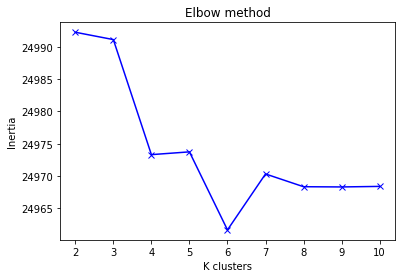

In [153]:
runKMeans(tfidf_2019, 10)

#### 2020

For n_clusters = 2 The average silhouette_score is : 0.0015931175787172588
For n_clusters = 3 The average silhouette_score is : 0.0009867334816834922
For n_clusters = 4 The average silhouette_score is : -0.0003995780568941424
For n_clusters = 5 The average silhouette_score is : -0.0005287445812394128
For n_clusters = 6 The average silhouette_score is : -0.0016621311540502102
For n_clusters = 7 The average silhouette_score is : -0.001485321451486861
For n_clusters = 8 The average silhouette_score is : -0.0018704940443198422
For n_clusters = 9 The average silhouette_score is : -0.0026249627256736833
For n_clusters = 10 The average silhouette_score is : -0.002260978186174155


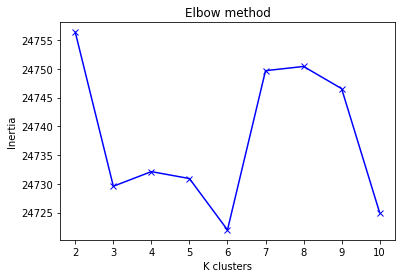

In [154]:
runKMeans(tfidf_2020, 10)

## LDA 2019

In [155]:
tweets['pp_list'] = tweets['pp'].str.split()

In [156]:
dictionary = Dictionary(tweets[tweets['date'].dt.year == 2019]['pp_list'].values)
dictionary.filter_extremes(no_below = 5, no_above = .5)
corpus = [dictionary.doc2bow(text) for text in tweets[tweets['date'].dt.year == 2019]['pp_list'].values]

In [157]:
%%time
model_2019 = LdaModel(corpus = corpus, id2word = dictionary, num_topics = 5, passes = 500)

Wall time: 43min 18s


In [158]:
model_2019.print_topics(num_words = 5)

[(0,
  '0.012*"años" + 0.007*"video" + 0.006*"vida" + 0.006*"historia" + 0.005*"así"'),
 (1,
  '0.037*"colombia" + 0.012*"hoy" + 0.012*"día" + 0.011*"mundo" + 0.009*"país"'),
 (2,
  '0.016*"presidente" + 0.013*"duque" + 0.012*"gobierno" + 0.012*"venezuela" + 0.008*"juan"'),
 (3,
  '0.014*"años" + 0.011*"bogotá" + 0.010*"dos" + 0.009*"hombre" + 0.009*"policía"'),
 (4,
  '0.019*"bogotá" + 0.007*"vía" + 0.007*"nacional" + 0.006*"así" + 0.006*"paro"')]

In [159]:
lda_display = pyLDAvis.gensim_models.prepare(model_2019, corpus, dictionary)
pyLDAvis.display(lda_display)

## LDA 2020

In [160]:
dictionary = Dictionary(tweets[tweets['date'].dt.year == 2020]['pp_list'].values)
dictionary.filter_extremes(no_below = 5, no_above = .5)
corpus = [dictionary.doc2bow(text) for text in tweets[tweets['date'].dt.year == 2020]['pp_list'].values]

In [161]:
%%time
model_2020 = LdaModel(corpus = corpus, id2word = dictionary, num_topics = 4, passes = 500)

Wall time: 47min 1s


In [162]:
model_2020.print_topics(num_words = 5)

[(0,
  '0.026*"coronavirus" + 0.021*"covid" + 0.019*"colombia" + 0.012*"país" + 0.010*"casos"'),
 (1,
  '0.010*"aquí" + 0.008*"bogotá" + 0.006*"lea" + 0.006*"gobierno" + 0.005*"colombia"'),
 (2,
  '0.014*"años" + 0.009*"dos" + 0.009*"bogotá" + 0.008*"caso" + 0.007*"policía"'),
 (3,
  '0.009*"aquí" + 0.009*"cómo" + 0.008*"duque" + 0.008*"presidente" + 0.007*"contamos"')]

In [130]:
display(tweets.iloc[49]['pp'])

'final game of thrones dejó opiniones divididas guayabo seguidores gt gt gt'

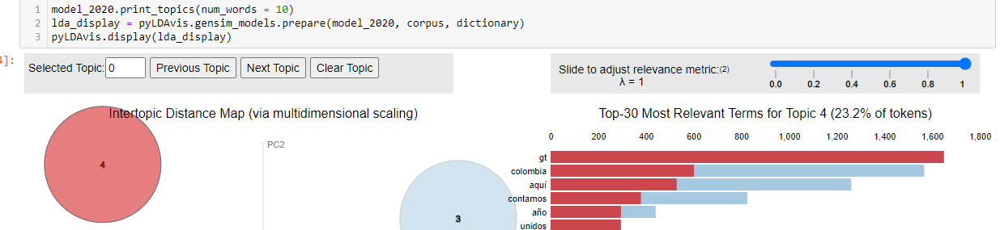

In [163]:
model_2020.print_topics(num_words = 10)
lda_display = pyLDAvis.gensim_models.prepare(model_2020, corpus, dictionary)
pyLDAvis.display(lda_display)

### Emojis 2019

In [20]:
plotEmojis(tweets[tweets['date'].dt.year == 2019]['emojis'])

### Emojis 2020

In [21]:
plotEmojis(tweets[tweets['date'].dt.year == 2020]['emojis'])

### wordcloud 2019

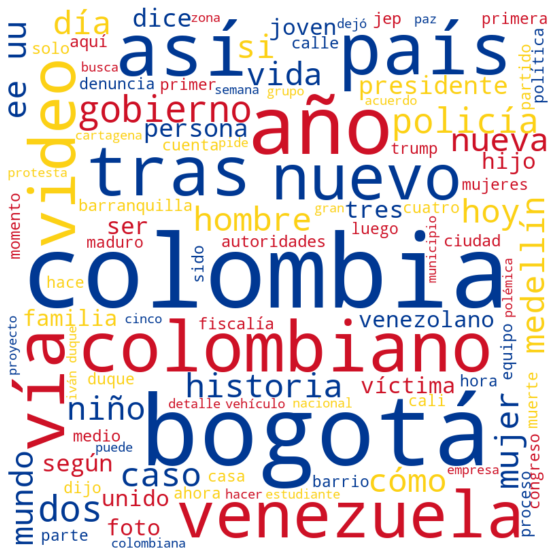

In [242]:
makeWordCloud(tweets[tweets['date'].dt.year == 2019]['pp'])

### wordcloud 2020

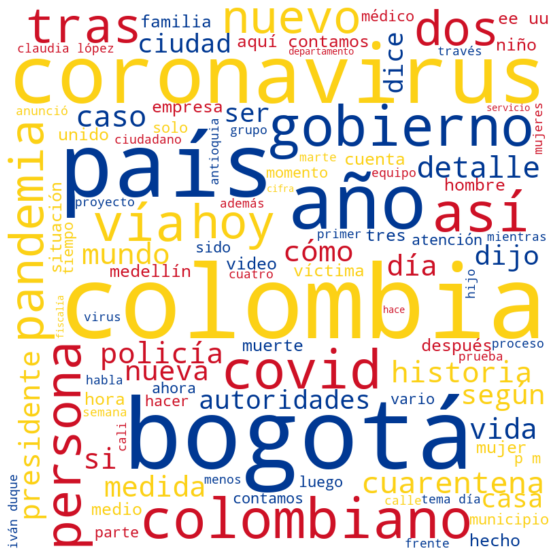

In [243]:
makeWordCloud(tweets[tweets['date'].dt.year == 2020]['pp'])